In [45]:
import torch
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import io
from torchvision import transforms as T
from transforms import *

In [59]:
def show_images(image1, image2):
    images = torch.cat([image1, image2], dim=2)
    images = Image.fromarray(images.permute(1, 2, 0).numpy())
    return images

def show_image_labels(image, label, img, lbl):
    images = torch.cat([image, img], dim=2)
    labels = torch.cat([label, lbl], dim=2)
    image_labels = torch.cat([images, labels], dim=1)
    image_labels = Image.fromarray(image_labels.permute(1, 2, 0).numpy())
    return image_labels

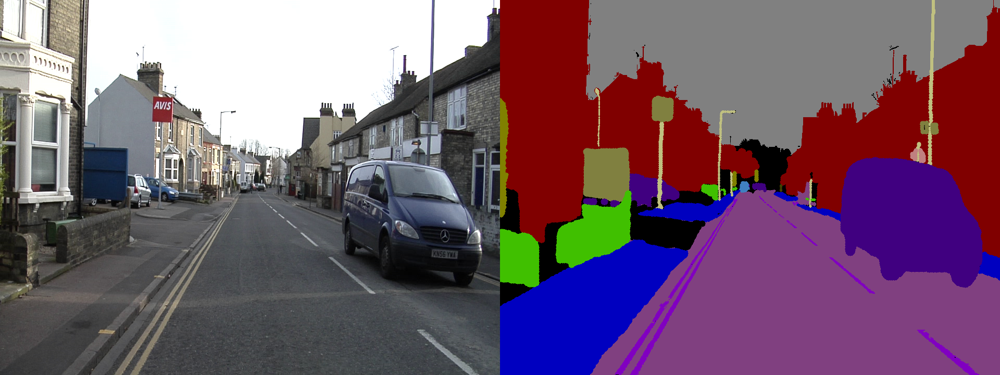

In [60]:
img_path = '../assests/image_labels/Seq05VD_f05100.png'
label_path = '../assests/image_labels/Seq05VD_f05100_L.png'
image = io.read_image(img_path)
label = io.read_image(label_path)
show_images(image, label)

## AdjustGamma

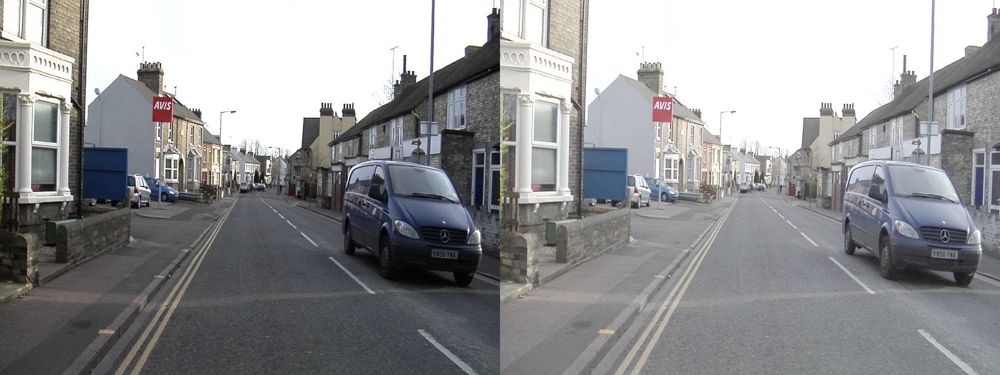

In [47]:
img, lbl = AdjustGamma(gamma=0.5, gain=1)(image, label)
show_images(image, img)

## AdjustSharpness

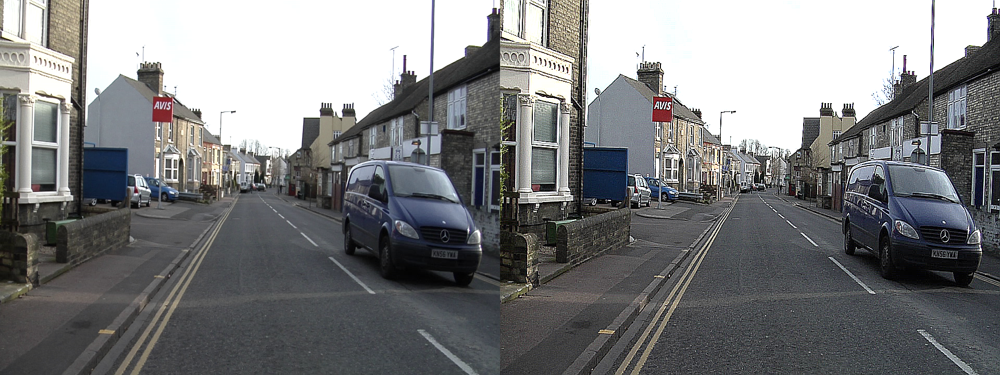

In [50]:
img, lbl = RandomAdjustSharpness(10, p=1.0)(image, label)
show_images(image, img)

## AutoContrast

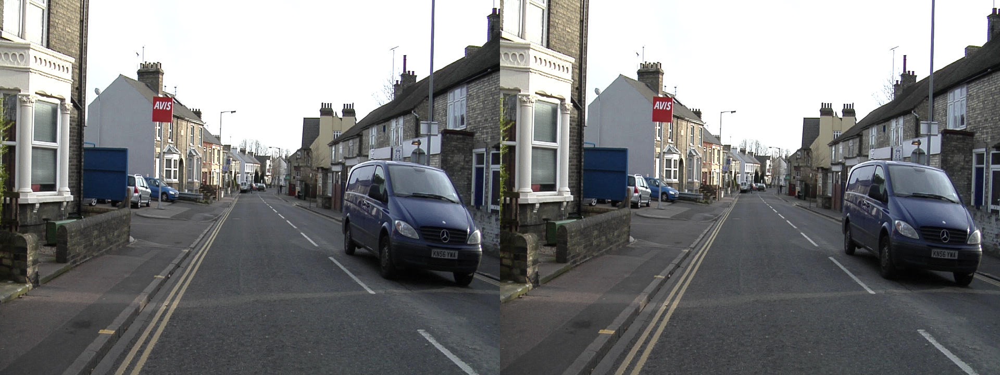

In [51]:
img, lbl = RandomAutoContrast(p=1.0)(image, label)
show_images(image, img)

## GaussianBlur

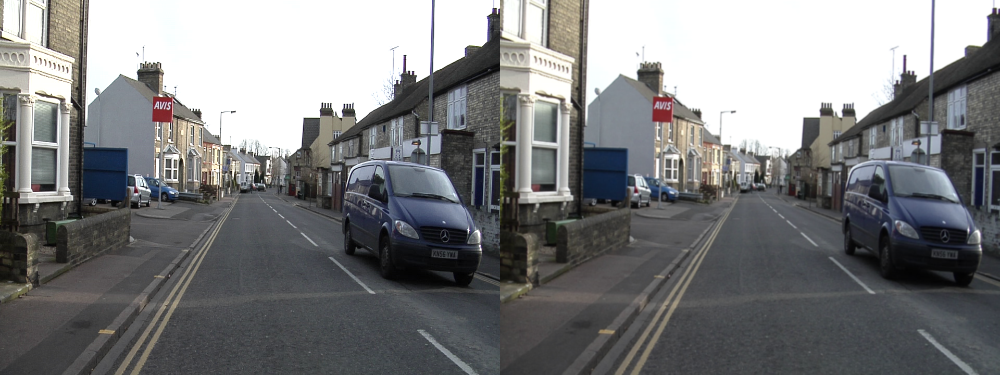

In [53]:
img, lbl = RandomGaussianBlur(5, p=1.0)(image, label)
show_images(image, img)

## Grayscale

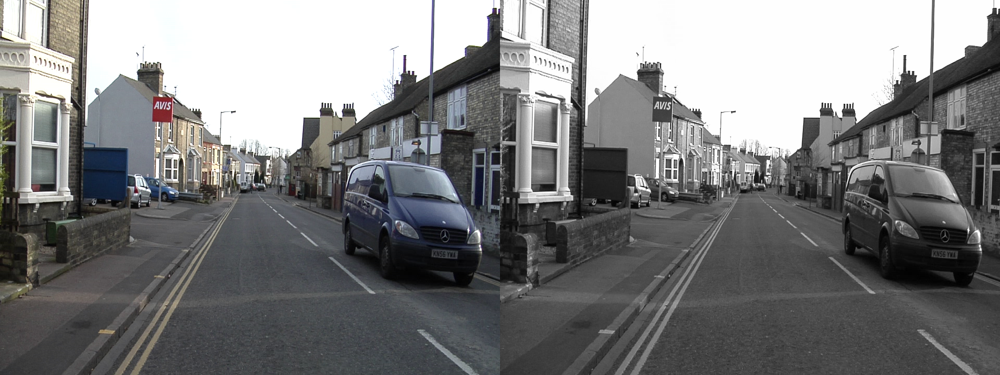

In [54]:
# channel size remains to 3 instead of 1
img, lbl = RandomGrayscale(p=1.0)(image, label)
show_images(image, img)

## RandomRotation

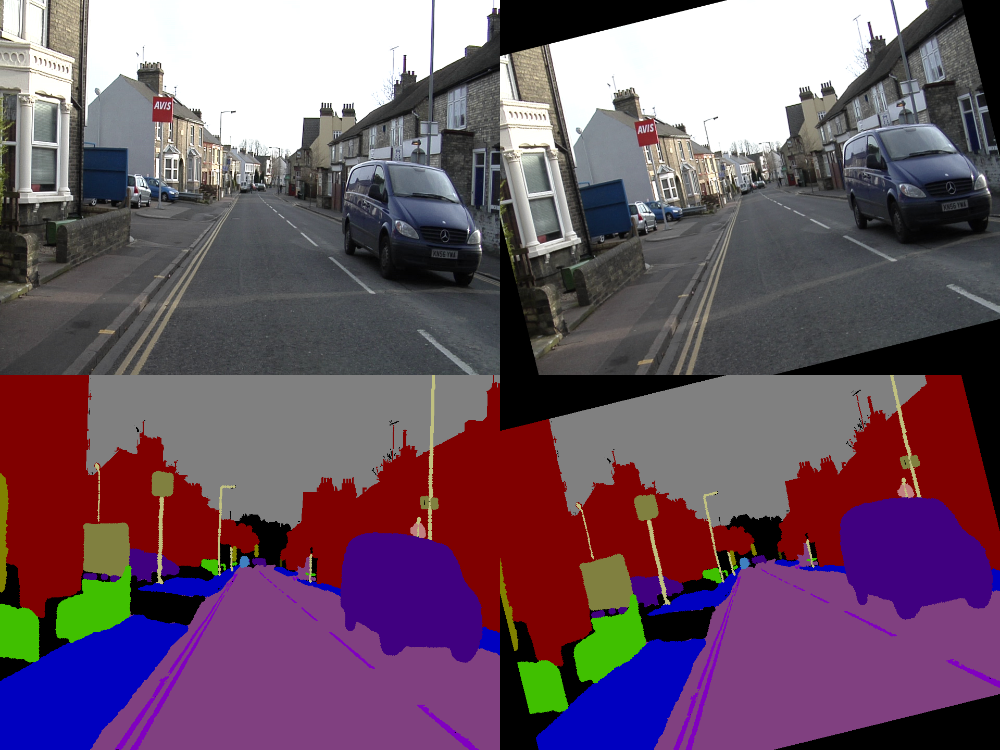

In [56]:
img, lbl = RandomRotation(30, p=1.0, seg_fill=0)(image, label)
show_image_labels(image, label, img, lbl)

## CenterCrop

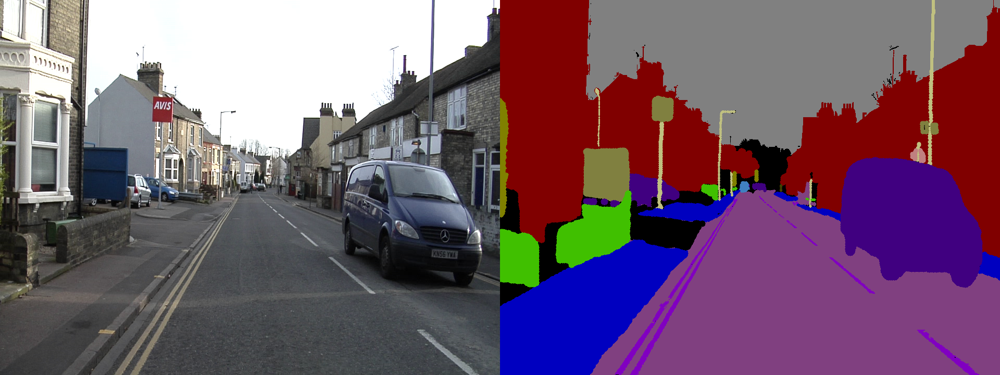

In [63]:
img, lbl = CenterCrop((320, 320))(image, label)
show_images(image, label)   # original 

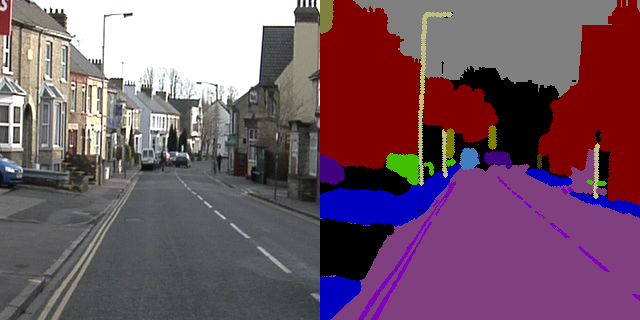

In [64]:
show_images(img, lbl)  # center crop to (320, 320)

## RandomCrop

Crop at random location. (Like a zoom-in effect)

torch.Size([3, 720, 960]) torch.Size([3, 720, 960])


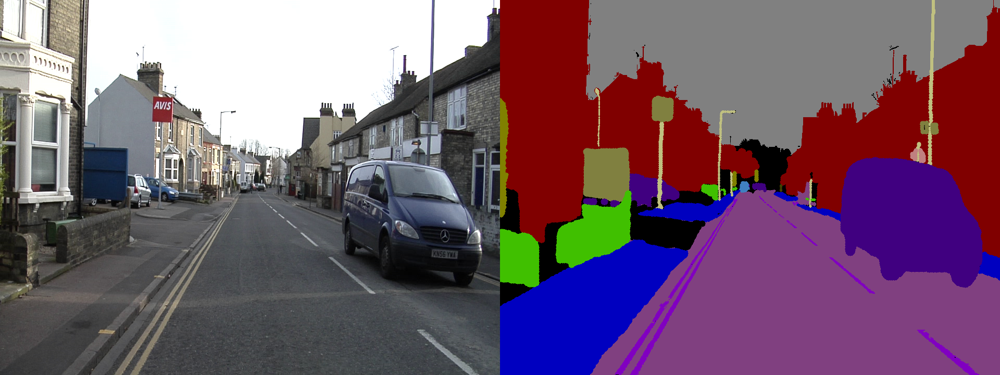

In [86]:
img, lbl = RandomCrop((320, 320), p=1.0)(image, label)
print(image.shape, label.shape)
show_images(image, label)   # original 

torch.Size([3, 320, 320]) torch.Size([3, 320, 320])


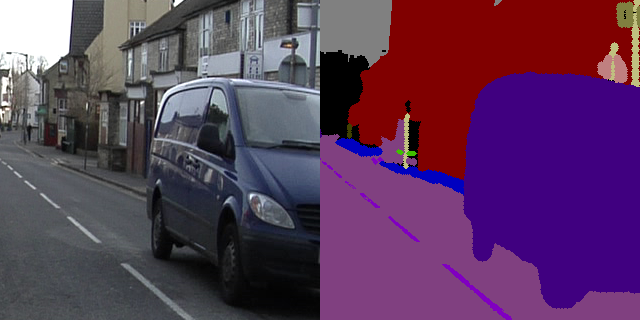

In [87]:
print(img.shape, lbl.shape)
show_images(img, lbl)

## Pad

Pad the image to given size.

torch.Size([3, 720, 960]) torch.Size([3, 720, 960])


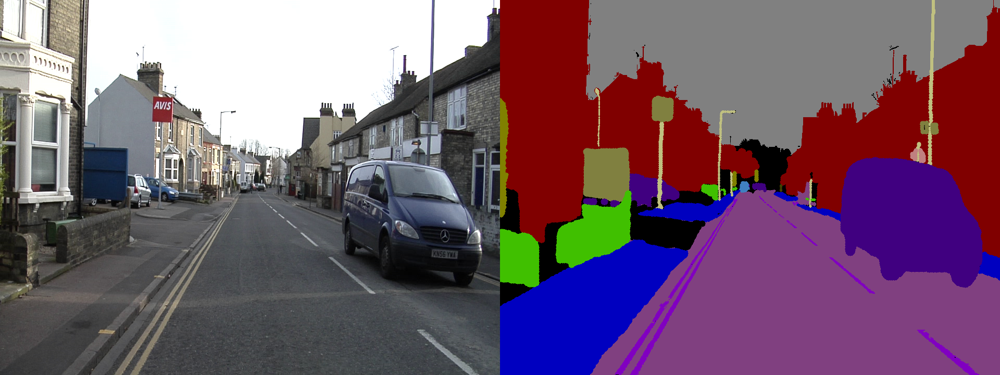

In [72]:
img, lbl = Pad((1024, 1024), seg_fill=0)(image, label)
print(image.shape, label.shape)
show_images(image, label)   # original 

torch.Size([3, 1024, 1024]) torch.Size([3, 1024, 1024])


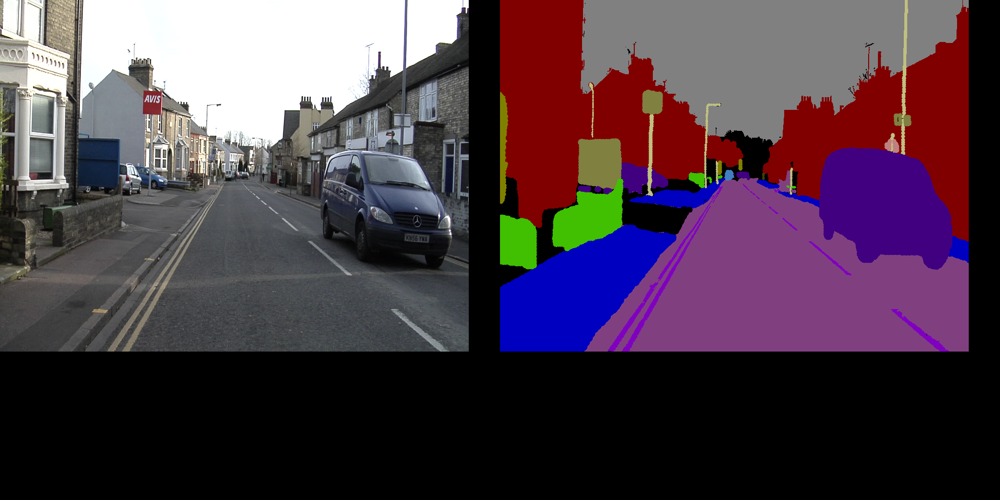

In [73]:
print(img.shape, lbl.shape)
show_images(img, lbl)

torch.Size([3, 480, 640]) torch.Size([3, 480, 640])


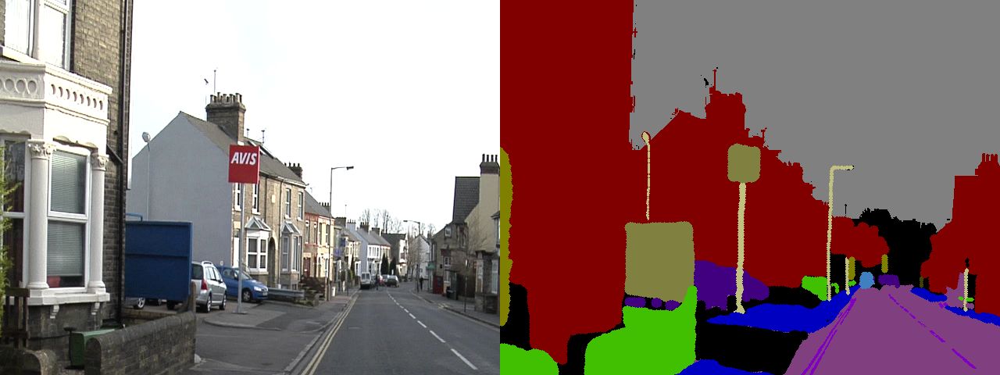

In [76]:
# if pad output size is less than original, then crop the image start from the corner
# not the same as RandomCrop; which will crop at random location instead of from the corner
img, lbl = Pad((480, 640), seg_fill=0)(image, label)
print(img.shape, lbl.shape)
show_images(img, lbl)   

## ResizePad

Nearly the same as Pad but uses resize instead of crop in **Pad**.

torch.Size([3, 720, 960]) torch.Size([3, 720, 960])


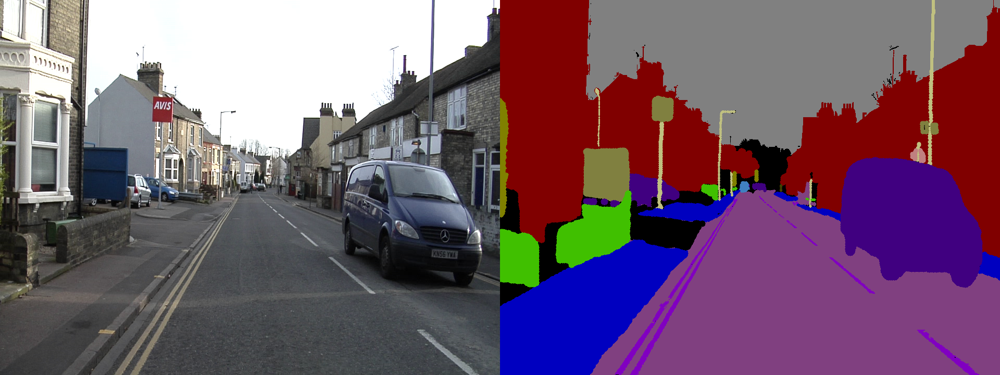

In [79]:
img, lbl = ResizePad((1024, 1024), seg_fill=0)(image, label)
print(image.shape, label.shape)
show_images(image, label)   # original 

torch.Size([3, 1024, 1024]) torch.Size([3, 1024, 1024])


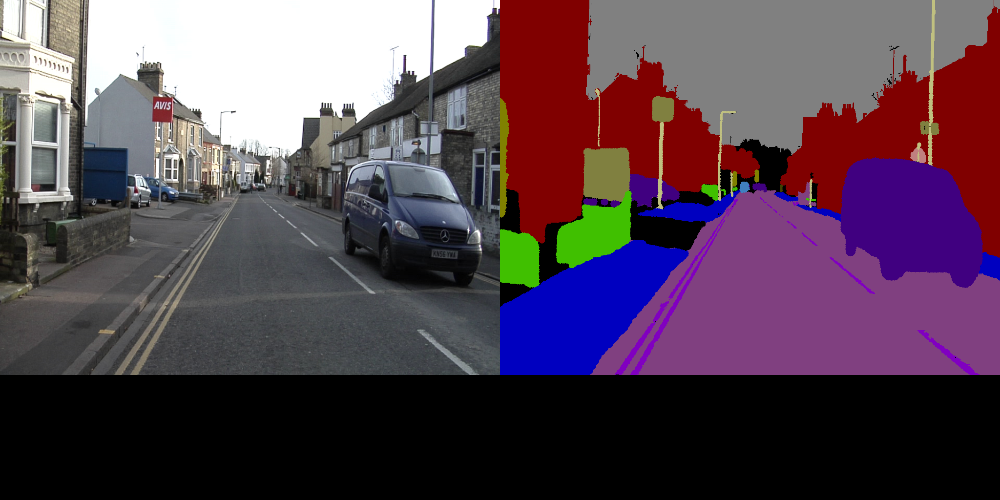

In [80]:
print(img.shape, lbl.shape)
show_images(img, lbl)

torch.Size([3, 480, 640]) torch.Size([3, 480, 640])


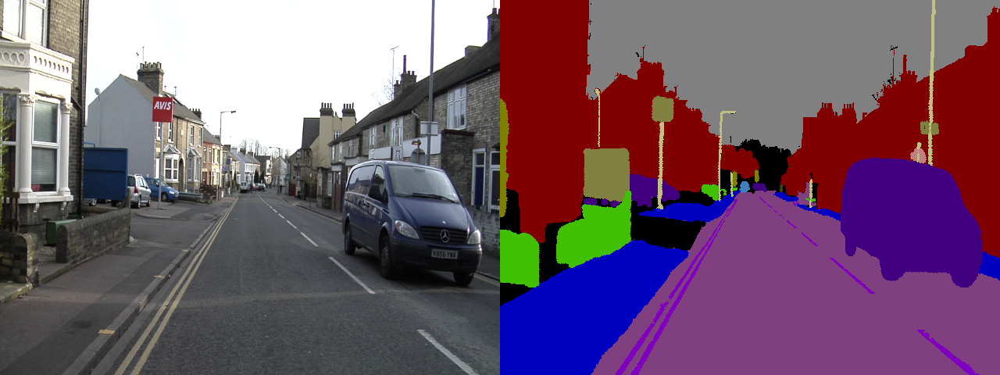

In [81]:
img, lbl = ResizePad((480, 640), seg_fill=0)(image, label)
print(img.shape, lbl.shape)
show_images(img, lbl)   

## Resize

Resize the shortest image size to the target size while maintaing the aspect ratio. And also make it divisible by stride 32. 

Notes: This will make the image sizes not equal; which is not suitable to use in training.

torch.Size([3, 720, 960]) torch.Size([3, 720, 960])


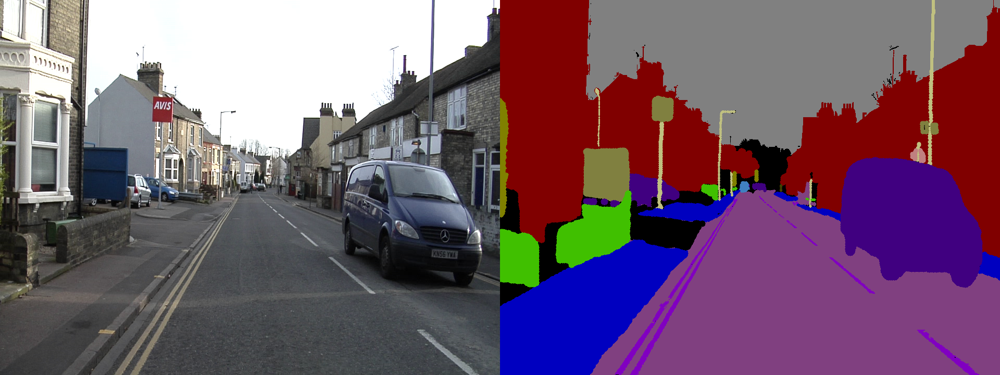

In [83]:
img, lbl = Resize((512, 512))(image, label)
print(image.shape, label.shape)
show_images(image, label)   # original 

torch.Size([3, 512, 704]) torch.Size([3, 512, 704])


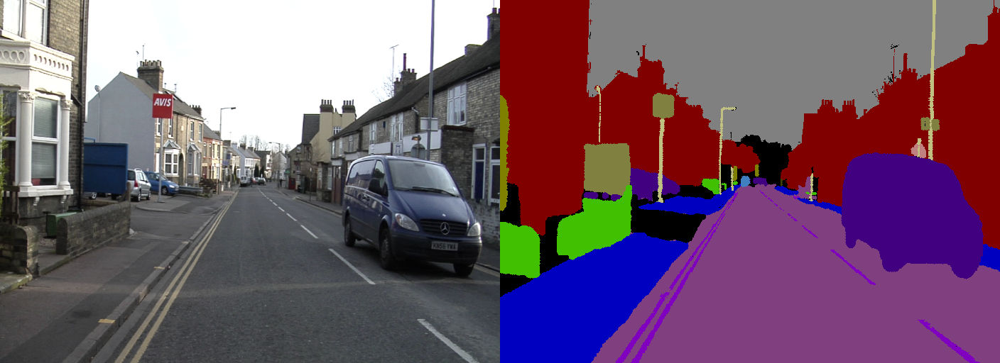

In [84]:
# as u can see, the other side is not 512 but maintains the aspect ratio
print(img.shape, lbl.shape)
show_images(img, lbl)

torch.Size([3, 1024, 1376]) torch.Size([3, 1024, 1376])


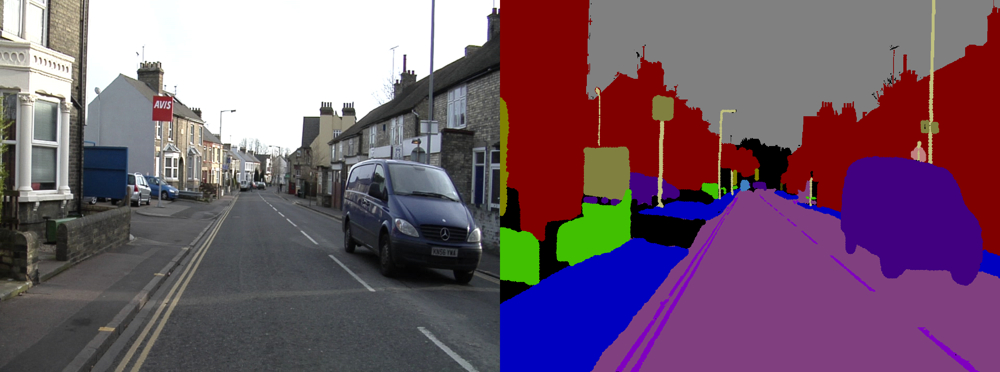

In [85]:
img, lbl = Resize((1024, 1024))(image, label)
print(img.shape, lbl.shape)
show_images(img, lbl)  

## RandomResizedCrop

Combination of **RandomCrop** and **ResizePad**.

torch.Size([3, 720, 960]) torch.Size([3, 720, 960])


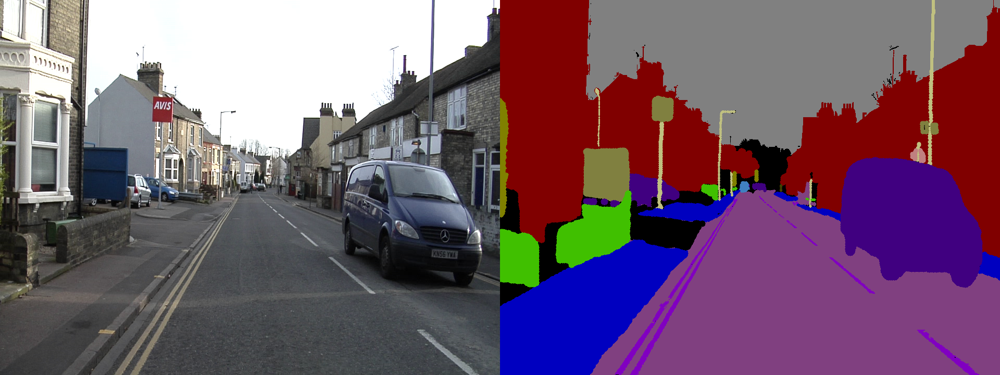

In [89]:
img, lbl = RandomResizedCrop((512, 512), (0.5, 2.0), seg_fill=0)(image, label)
print(image.shape, label.shape)
show_images(image, label)   # original 

torch.Size([3, 512, 512]) torch.Size([3, 512, 512])


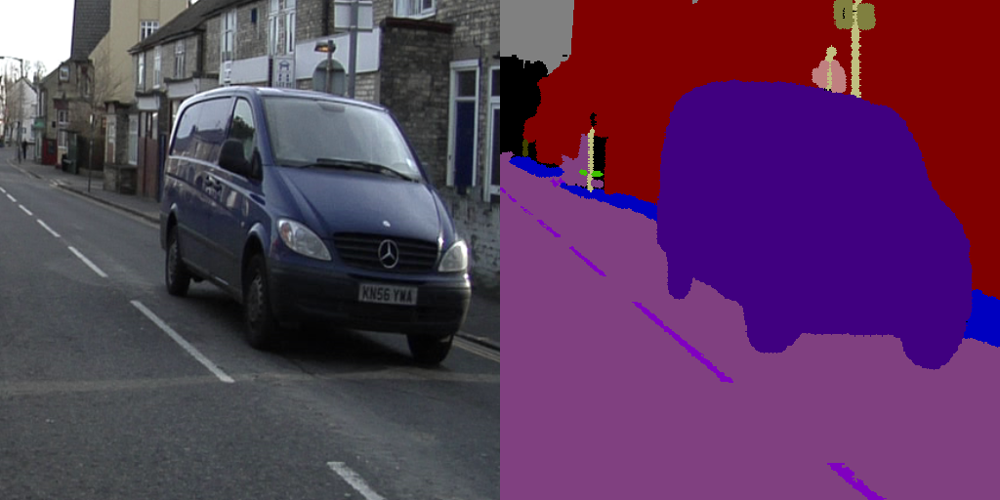

In [90]:
# as u can see, the other side is not 512 but maintains the aspect ratio
print(img.shape, lbl.shape)
show_images(img, lbl)

torch.Size([3, 1024, 1024]) torch.Size([3, 1024, 1024])


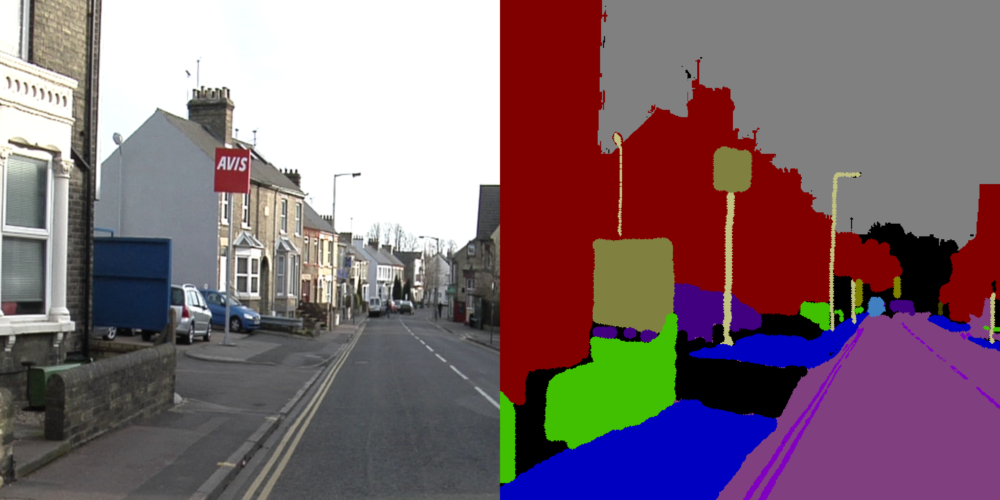

In [94]:
img, lbl = RandomResizedCrop((1024, 1024), (0.5, 2.0), seg_fill=0)(image, label)
print(img.shape, lbl.shape)
show_images(img, lbl)   

torch.Size([3, 1024, 1024]) torch.Size([3, 1024, 1024])


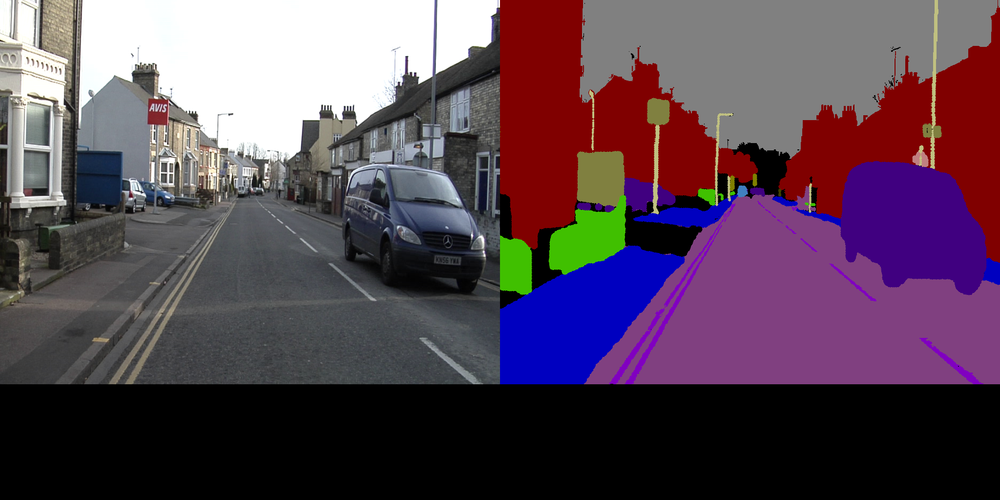

In [95]:
img, lbl = RandomResizedCrop((1024, 1024), (0.5, 2.0), seg_fill=0)(image, label)
print(img.shape, lbl.shape)
show_images(img, lbl)    

torch.Size([3, 1024, 1024]) torch.Size([3, 1024, 1024])


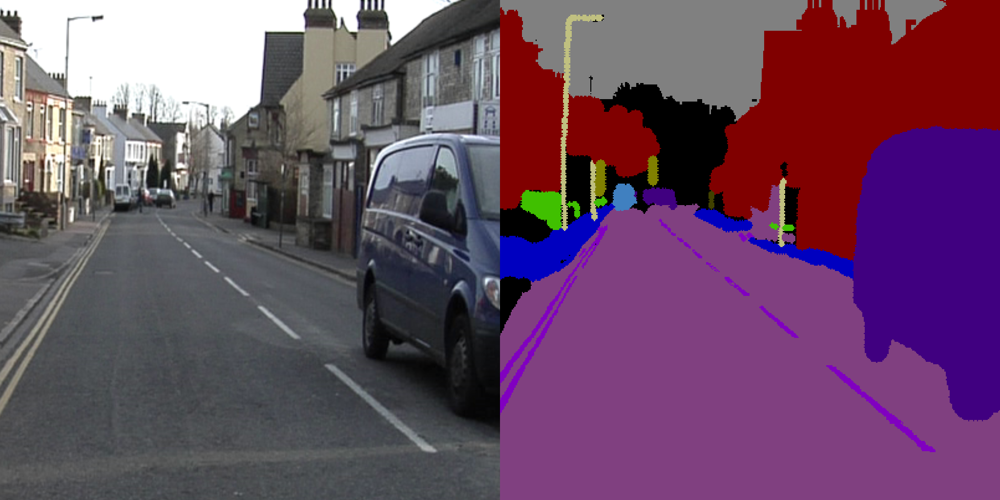

In [96]:
img, lbl = RandomResizedCrop((1024, 1024), (0.5, 2.0), seg_fill=0)(image, label)
print(img.shape, lbl.shape)
show_images(img, lbl)   